# Computer Vision Chapter Two

## Import Statements

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
cv2.__version__

'3.4.2'

## Helper Functions

In [3]:
def showImg(img, title = ''):
    plt.figure(figsize = (20,15));
    plt.title(title)
    plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))

def showGrayScaleImg(img, title = ''):
    plt.figure(figsize = (20,15));
    plt.title(title)
    plt.imshow(img, cmap='gray')

## Afine transformations

### Translations

In [4]:
barcelona = cv2.imread('img/barcelona.jpg');

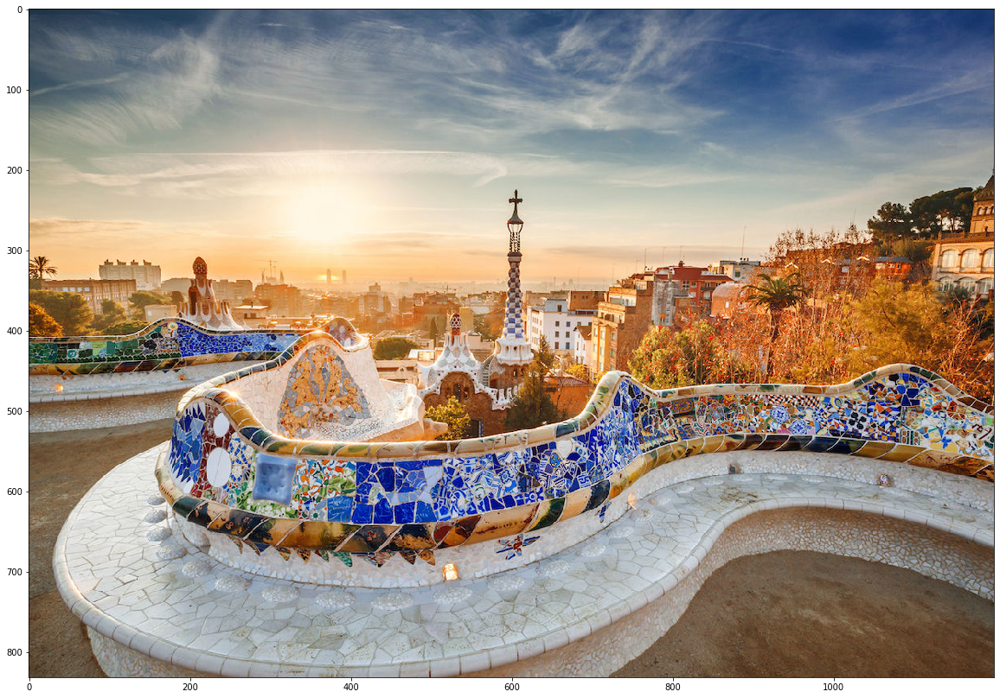

In [5]:
showImg(barcelona)

In [6]:
height, width = barcelona.shape[:2]

In [7]:
print(
    f'The image height is: {height} pixels\nThe image Width is: {width} pixels'
)

The image height is: 832 pixels
The image Width is: 1200 pixels


In [8]:
translation_matrix = np.float32(
    [
        [1, 0, 100], # Translation in the x axis
        [0, 1, 300] # translation in the y axis
    ])

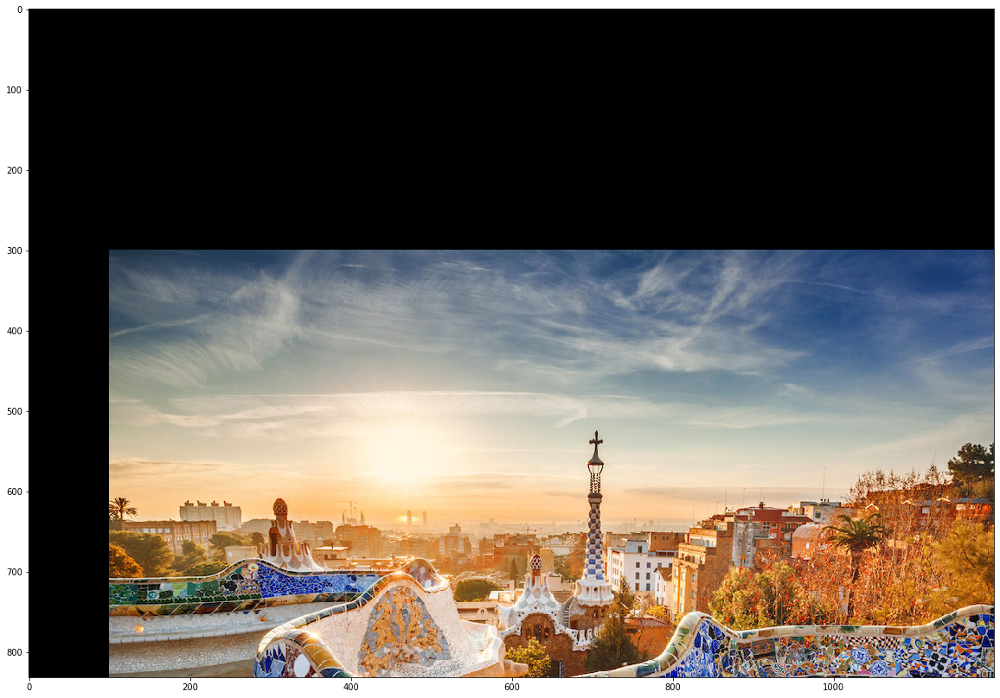

In [9]:
barcelona_img_translation = cv2.warpAffine(barcelona, translation_matrix,
                                           (width, height))
showImg(barcelona_img_translation)

### Rotation

In [10]:
x_center = width / 2
y_center = height / 2
angle_of_rotation = 0
scale = 0.5
rotation_matrix = cv2.getRotationMatrix2D((x_center, y_center),
                                          angle_of_rotation, scale)

In [11]:
rotation_matrix

array([[  0.5,   0. , 300. ],
       [ -0. ,   0.5, 208. ]])

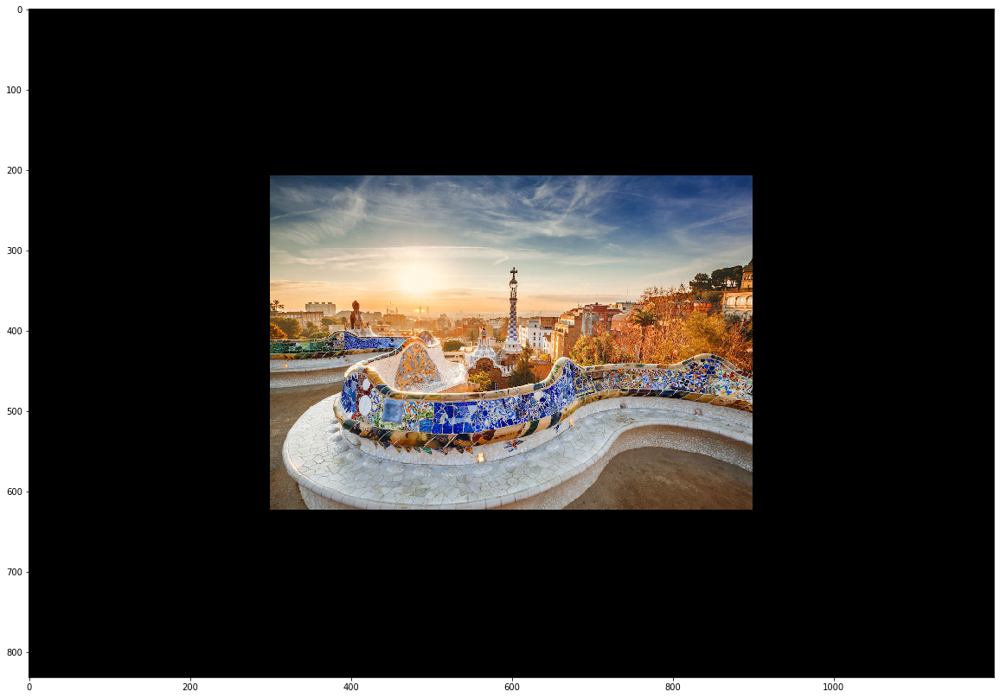

In [12]:
barcelona_img_rotated = cv2.warpAffine(barcelona, rotation_matrix,
                                       (width, height))
showImg(barcelona_img_rotated)

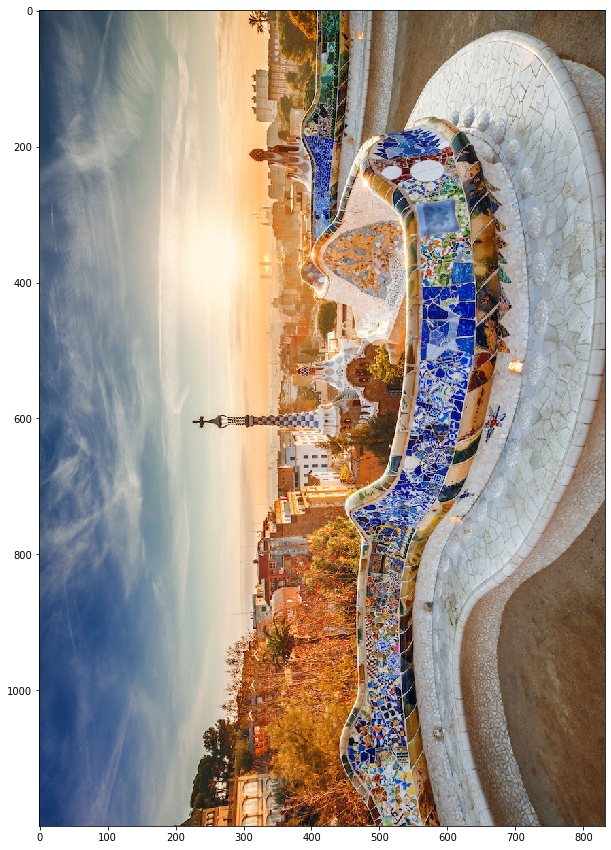

In [13]:
barcelona_img_rotated = cv2.transpose(barcelona);
showImg(barcelona_img_rotated)  

### Scaling images

#### Interpolation methods

* INTER_NEAREST - a nearest-neighbor interpolation (Fastest)
* INTER_LINEAR - a bilinear interpolation (used by default) (good for upsampling)
* INTER_AREA - resampling using pixel area relation. It may be a preferred method for image decimation, as it gives moire’-free results. But when the image is zoomed, it is similar to the INTER_NEAREST method. (Good for downsampling)
* INTER_CUBIC - a bicubic interpolation over 4x4 pixel neighborhood (Better)
* INTER_LANCZOS4 - a Lanczos interpolation over 8x8 pixel neighborhood (Best one)

#### Downsampling

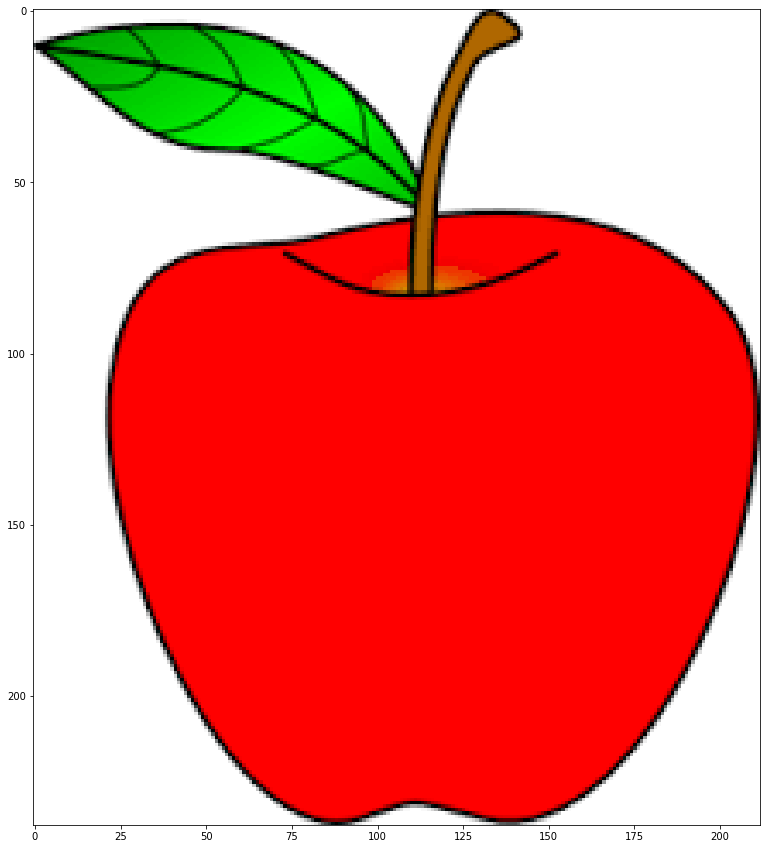

In [14]:
apple = cv2.imread('img/apple.png')
showImg(apple)

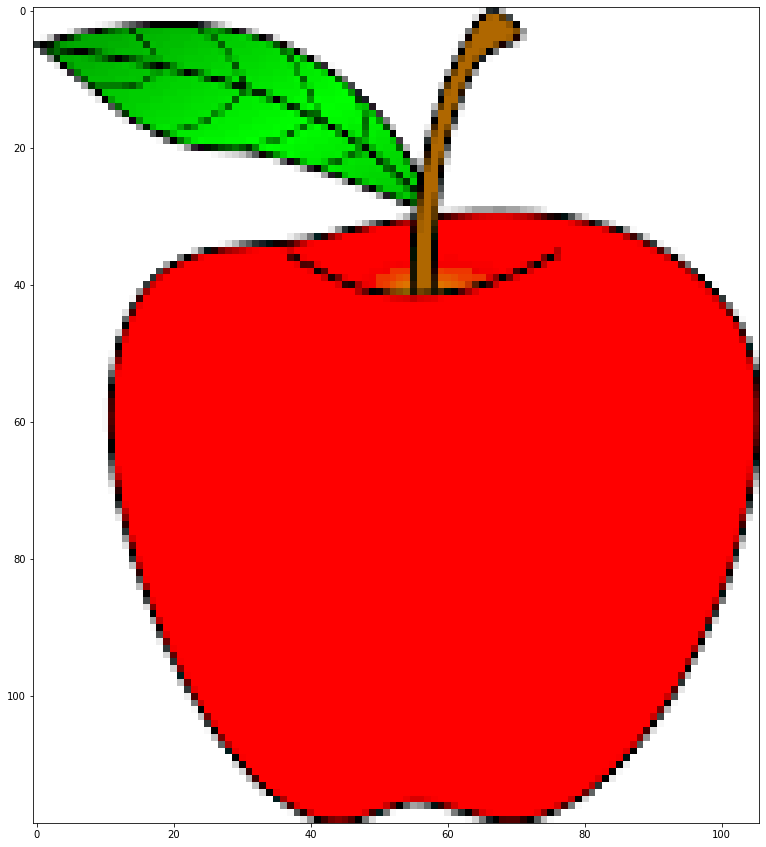

In [15]:
apple_height, apple_width = apple.shape[:2]
apple_resized = cv2.resize(apple, (apple_width // 2, apple_height // 2),
                           interpolation=cv2.INTER_NEAREST)
showImg(apple_resized)

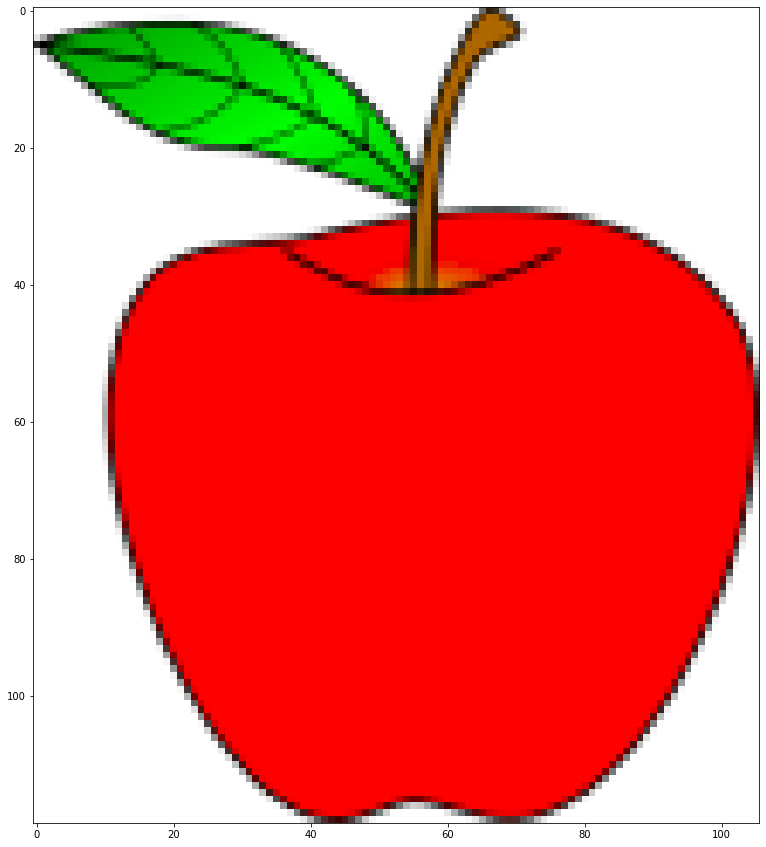

In [16]:
apple_height, apple_width = apple.shape[:2]
apple_resized = cv2.resize(apple, (apple_width // 2, apple_height // 2),
                           interpolation=cv2.INTER_AREA)
showImg(apple_resized)

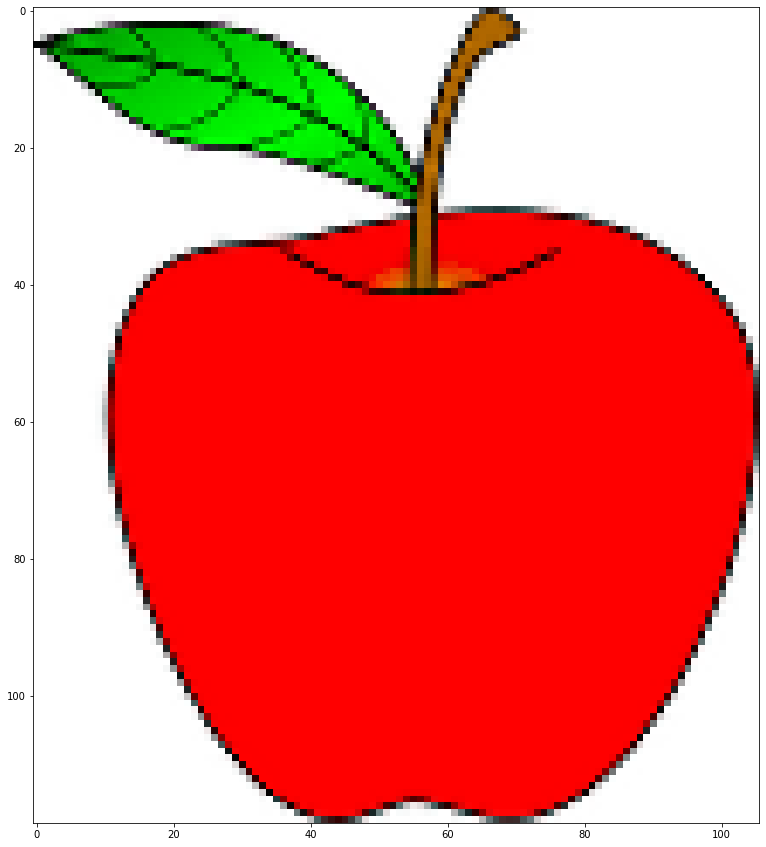

In [17]:
apple_resized = cv2.resize(apple,
                           None,
                           fx=0.5,
                           fy=0.5,
                           interpolation=cv2.INTER_LANCZOS4)
showImg(apple_resized)

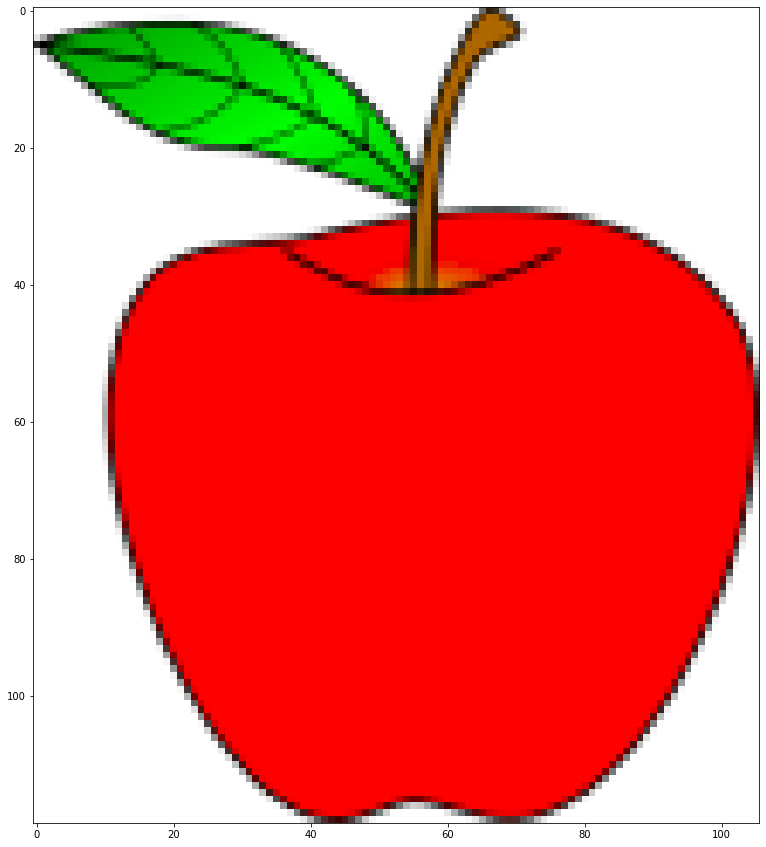

In [18]:
apple_resized = cv2.resize(apple, (apple_width // 2, apple_height // 2),
                           interpolation=cv2.INTER_LINEAR)
showImg(apple_resized)

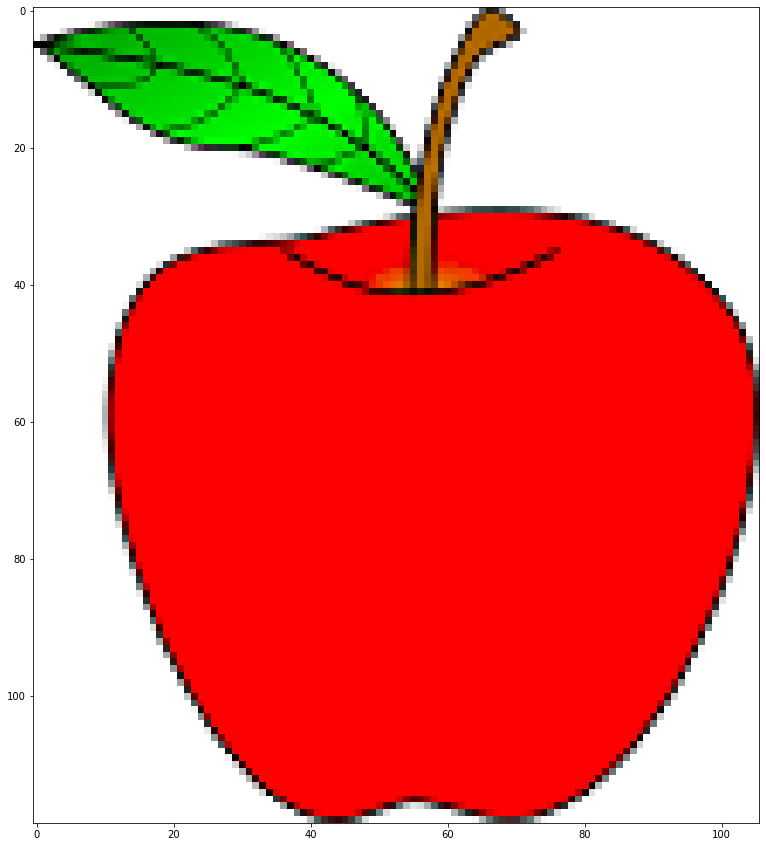

In [19]:
apple_resized = cv2.resize(apple,(apple_width//2,apple_height//2),interpolation = cv2.INTER_CUBIC)
showImg(apple_resized) 

#### Upsampling

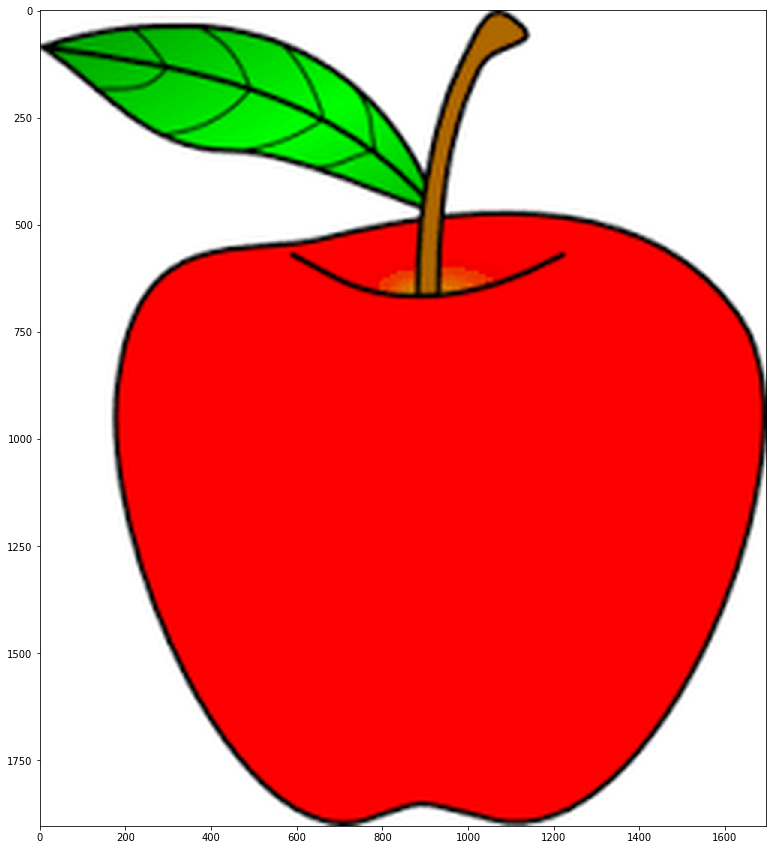

In [20]:
apple_resized = cv2.resize(apple,
                           None,
                           fx=8,
                           fy=8,
                           interpolation=cv2.INTER_LANCZOS4)
showImg(apple_resized)

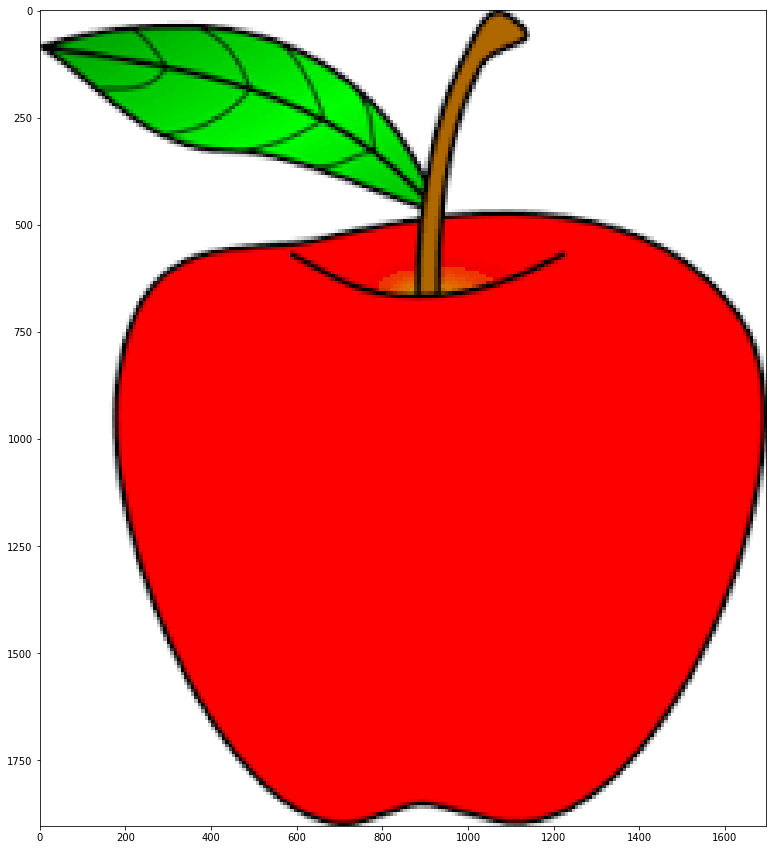

In [21]:
apple_resized = cv2.resize(apple,
                           None,
                           fx=8,
                           fy=8,
                           interpolation=cv2.INTER_AREA)
showImg(apple_resized)

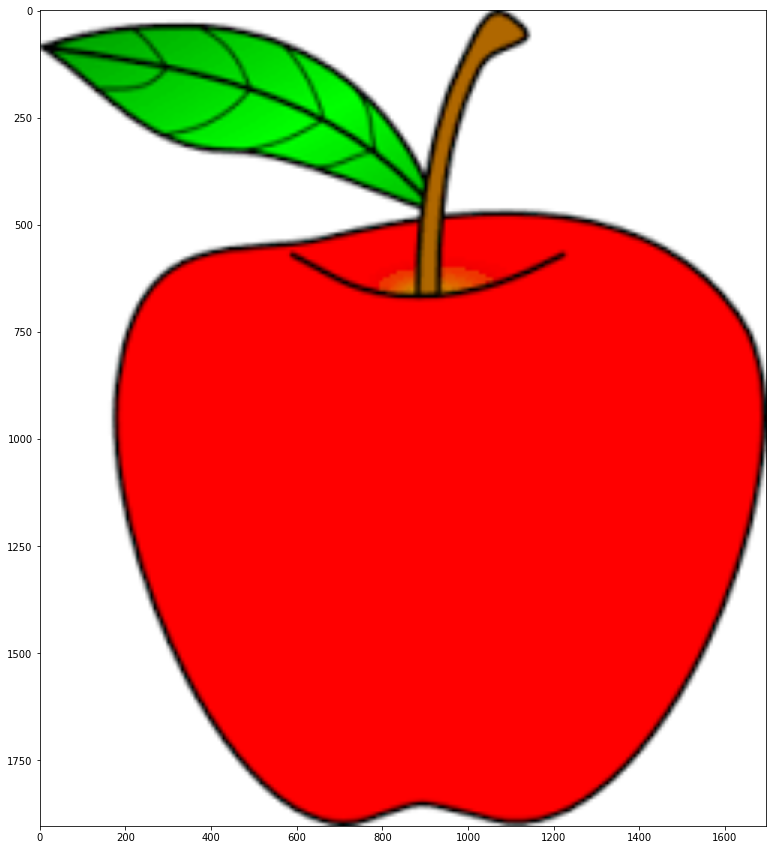

In [22]:
apple_resized = cv2.resize(apple,
                           None,
                           fx=8,
                           fy=8,
                           interpolation=cv2.INTER_LINEAR)
showImg(apple_resized)

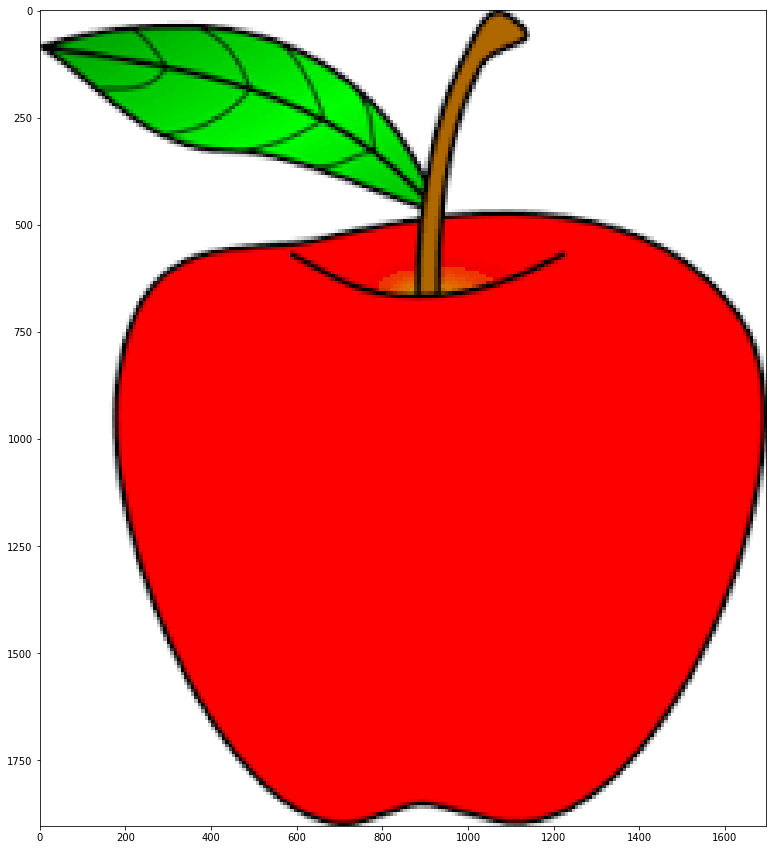

In [23]:
apple_resized = cv2.resize(apple,
                           None,
                           fx=8,
                           fy=8,
                           interpolation=cv2.INTER_NEAREST)
showImg(apple_resized)

## Image Pyramids

#### Gaussian pyramid (downsampling)

In [24]:
bcn_copy = barcelona.copy()
for i in range(5):
    bcn_copy = cv2.pyrDown(bcn_copy)
    cv2.imshow('pyr',bcn_copy)
    cv2.waitKey(3000)
    cv2.destroyAllWindows()

#### Laplacian Pyramids

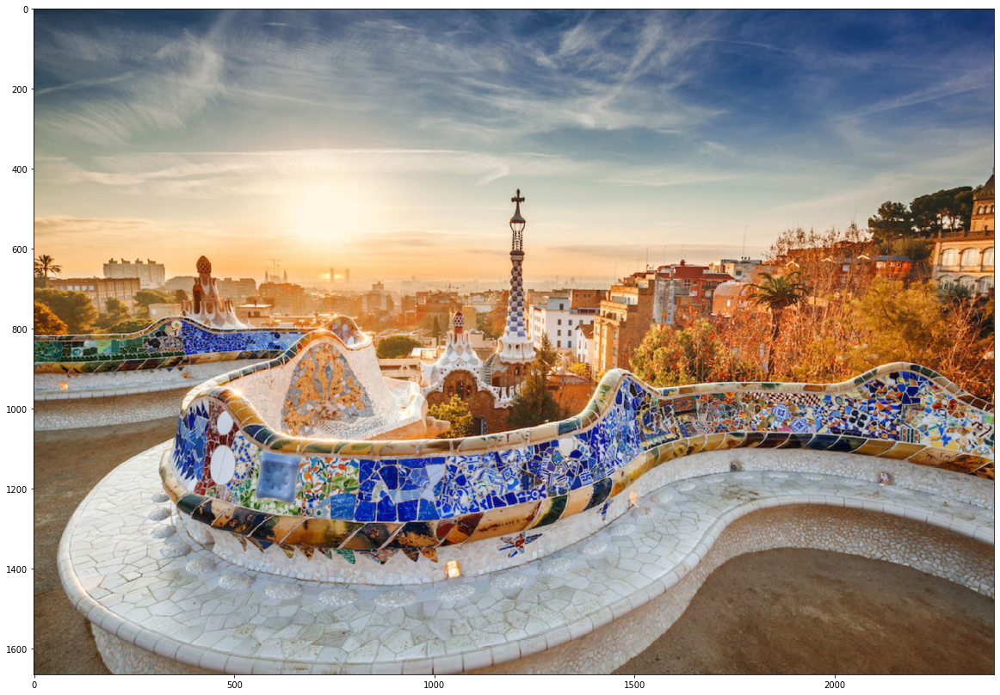

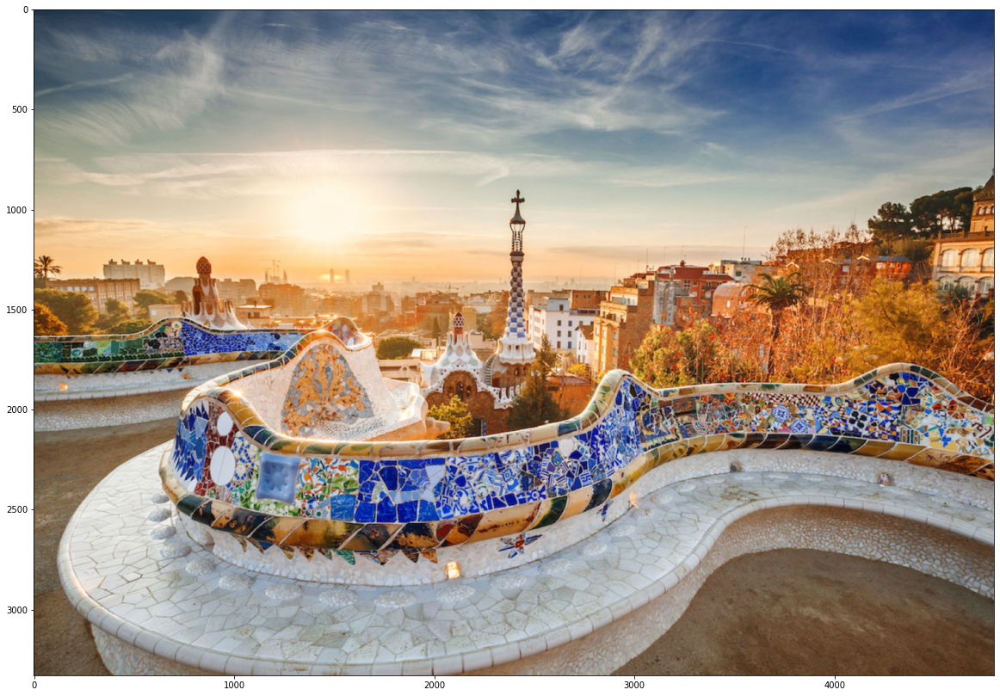

In [25]:
bcn_copy = barcelona.copy()
for i in range(2):
    bcn_copy = cv2.pyrUp(bcn_copy)
    showImg(bcn_copy)

You can learn more about image pyramids here: [Image Pyramids](https://docs.opencv.org/3.1.0/dc/dff/tutorial_py_pyramids.html)

##  Cropping

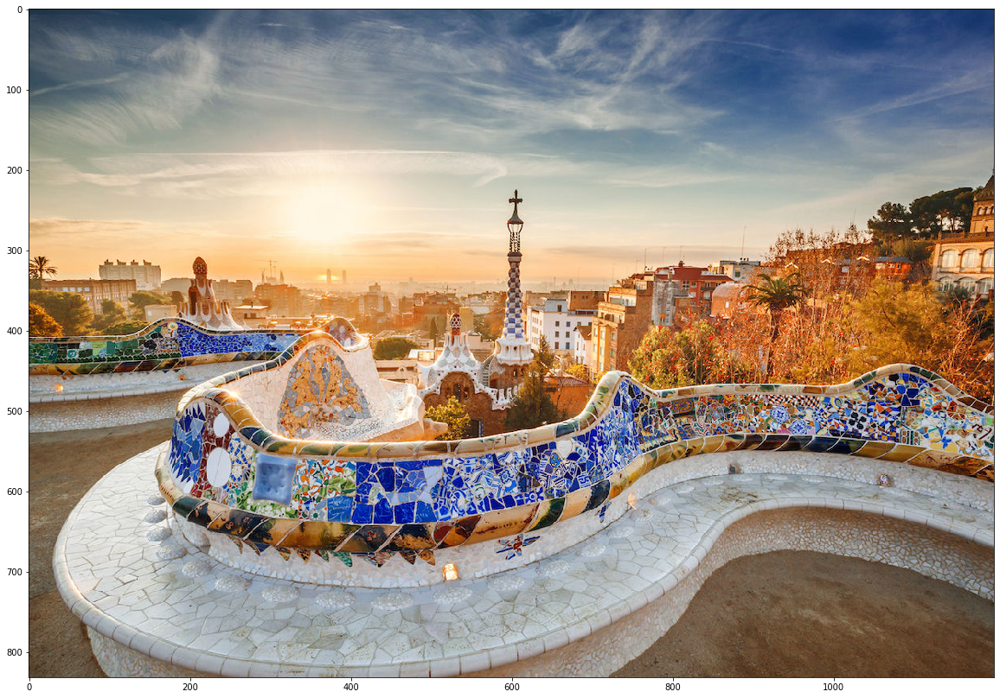

In [26]:
showImg(barcelona)

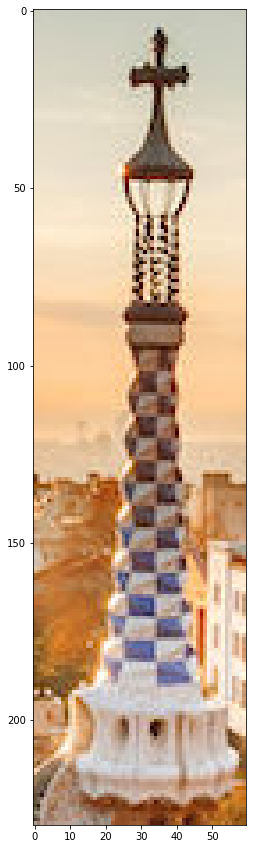

In [27]:
start_row = 220
end_row = 450

start_col = 570
end_col = 630

cropped_img = barcelona[start_row:end_row, start_col:end_col]
showImg(cropped_img)

## Brightening and darkening images

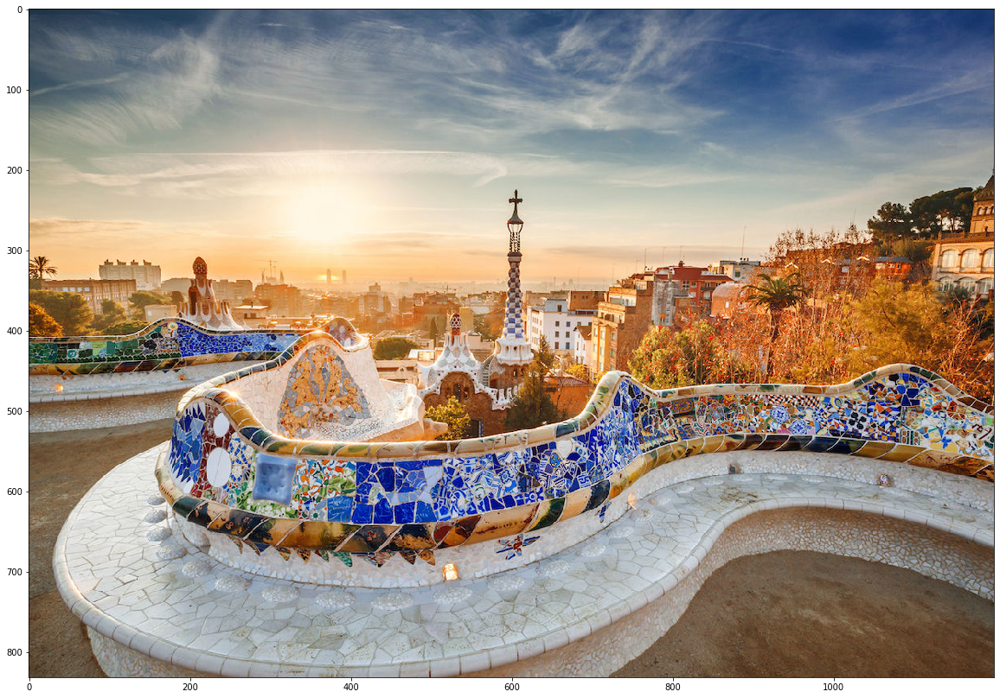

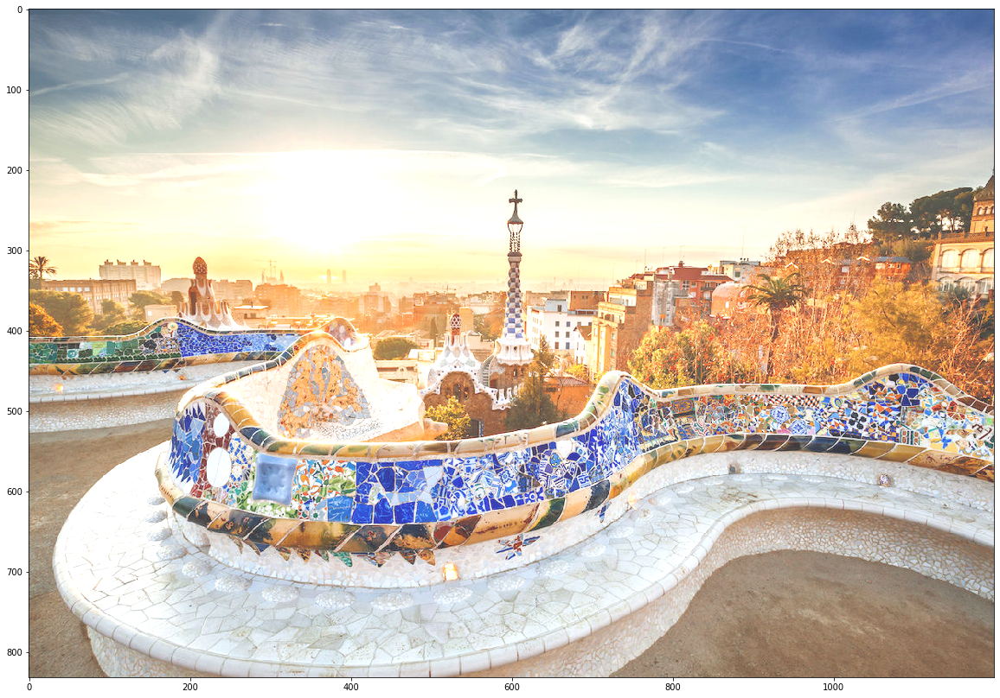

In [28]:
pixel_values_matrix = np.ones(barcelona.shape, dtype= "uint8") * 50

brightened_image = cv2.add(barcelona,pixel_values_matrix)
showImg(barcelona)
showImg(brightened_image)

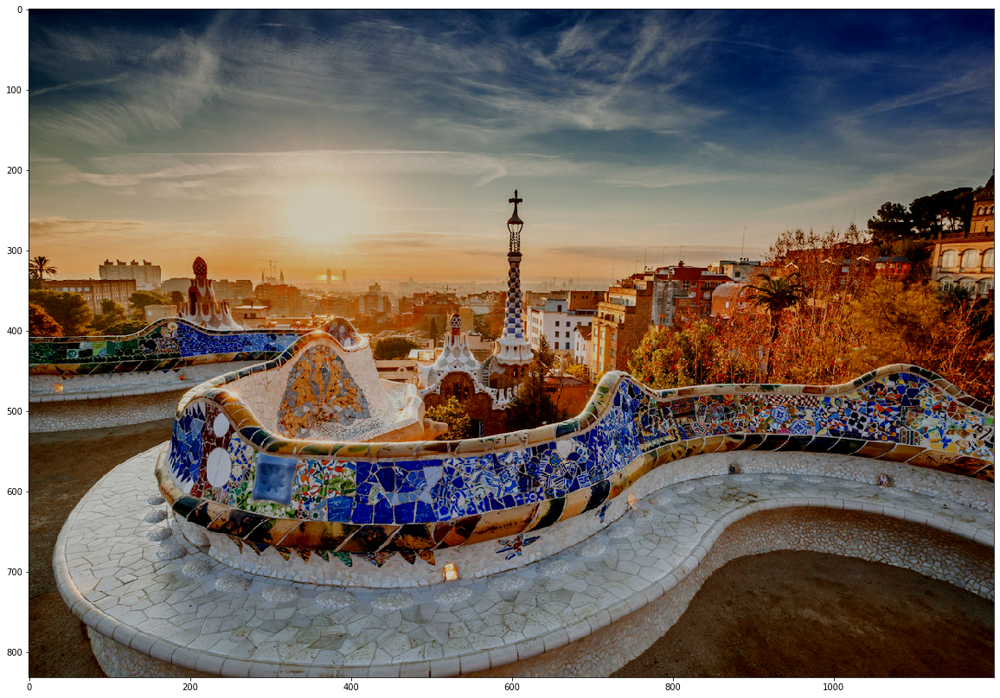

In [29]:
dark_image = cv2.subtract(barcelona,pixel_values_matrix)
showImg(dark_image)

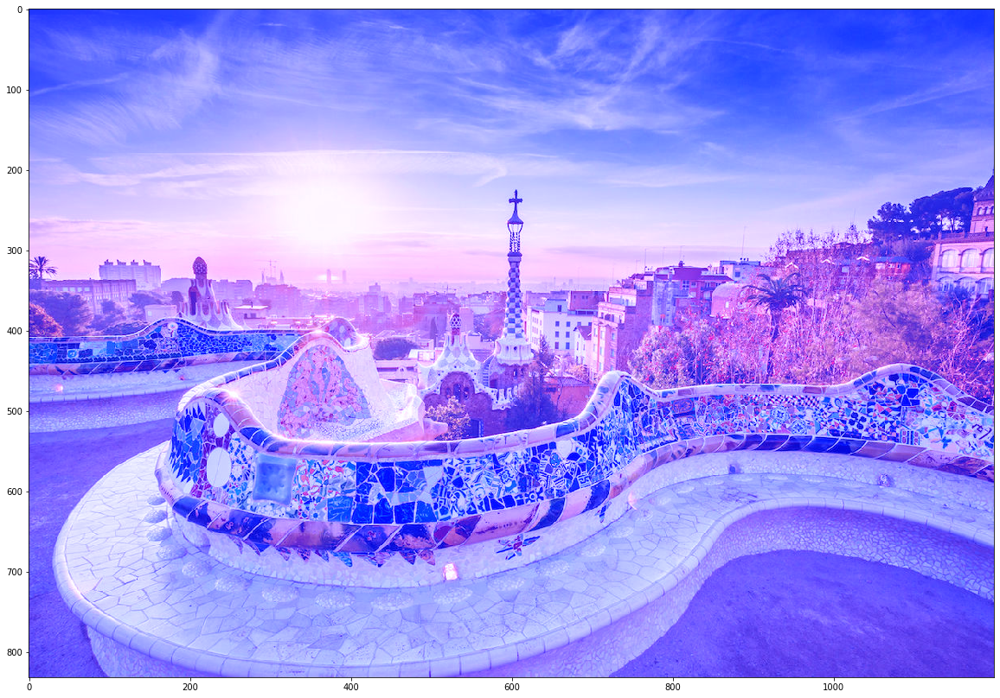

In [30]:
B, G, R = cv2.split(barcelona)

height, width = barcelona.shape[:2]

pixel_values_matrix_one_channel = np.ones((height, width), dtype="uint8") * 200

B = cv2.add(B, pixel_values_matrix_one_channel)

modified_img = cv2.merge([B, G, R])
showImg(modified_img)

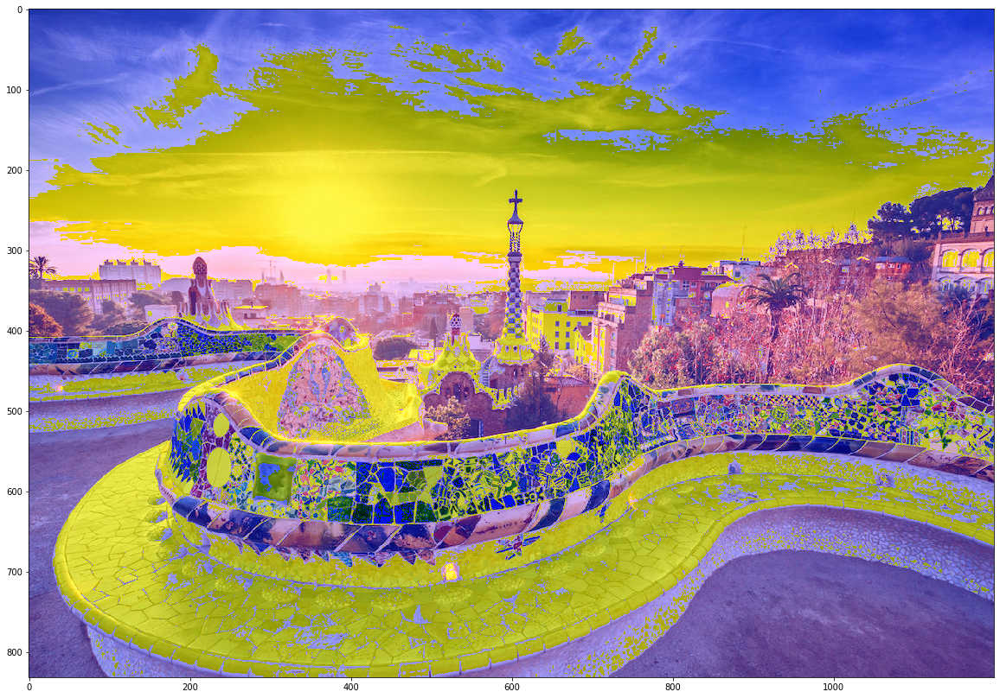

In [31]:
B, G, R = cv2.split(barcelona)

modified_img = cv2.merge([B+100,G,R])
showImg(modified_img)

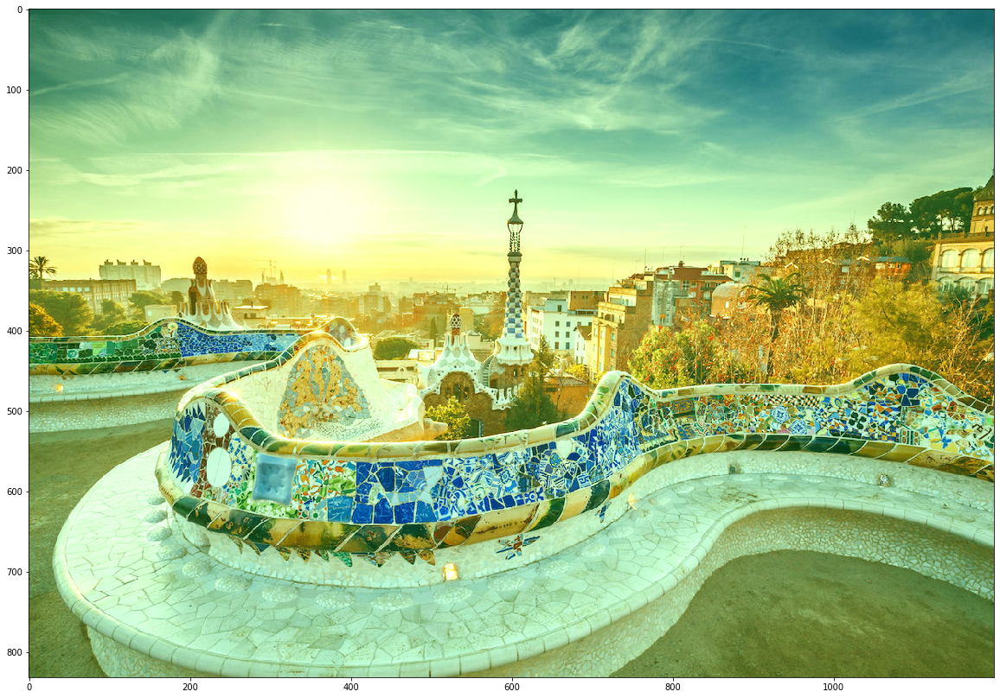

In [32]:
B, G, R = cv2.split(barcelona)

pixel_values_matrix_one_channel = np.ones((height, width), dtype= "uint8") * 50

G = cv2.add(G,pixel_values_matrix_one_channel)

modified_img = cv2.merge([B,G,R])
showImg(modified_img)

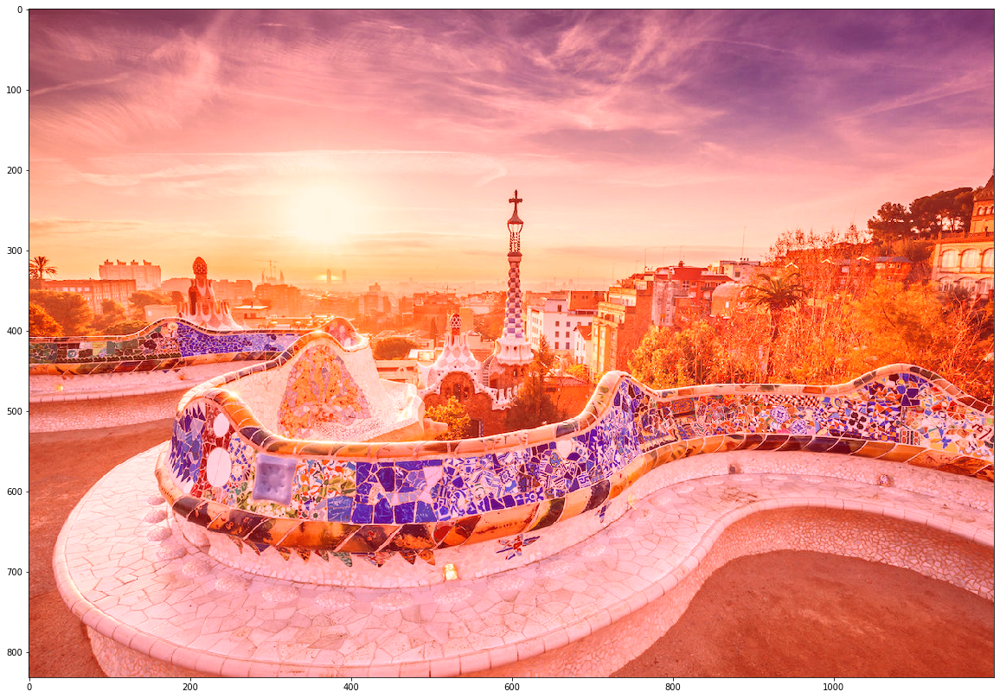

In [33]:
B, G, R = cv2.split(barcelona)

pixel_values_matrix_one_channel = np.ones((height, width), dtype= "uint8") * 100

R = cv2.add(R,pixel_values_matrix_one_channel)

modified_img = cv2.merge([B,G,R])
showImg(modified_img)

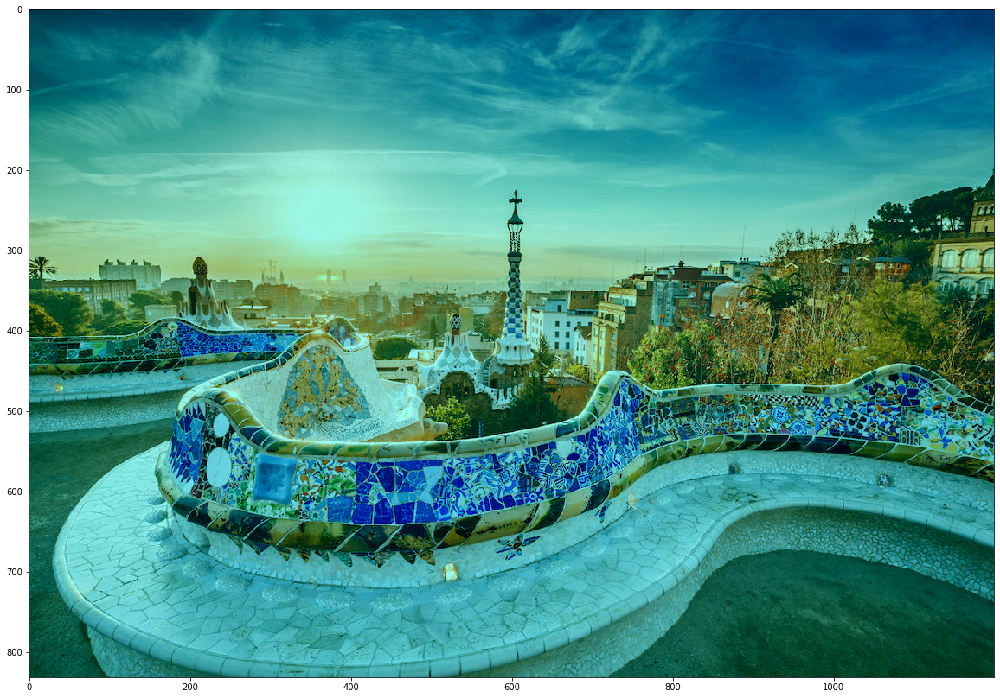

In [34]:
B, G, R = cv2.split(barcelona)

pixel_values_matrix_one_channel = np.ones((height, width), dtype= "uint8") * 100

R = cv2.subtract(R,pixel_values_matrix_one_channel)

modified_img = cv2.merge([B,G,R])
showImg(modified_img)

## Challenge time!

With what you already know try to clean up this image

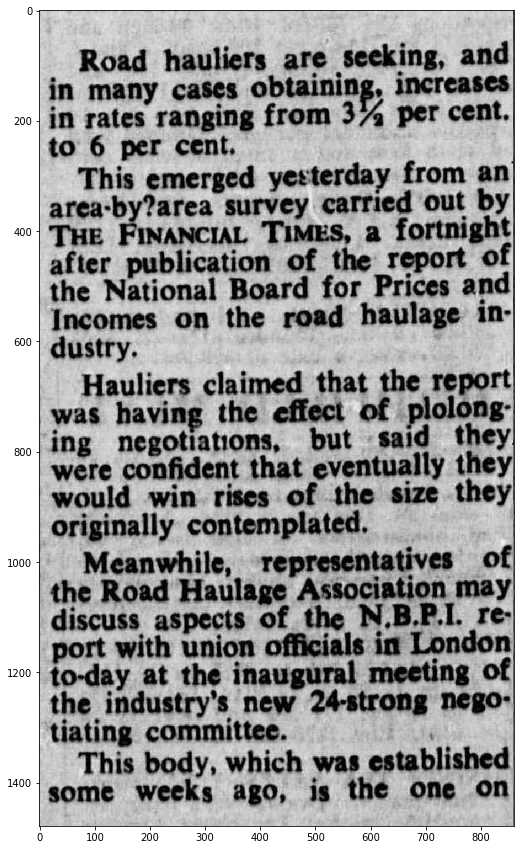

In [35]:
text_img = cv2.imread('img/text.png')
showImg(text_img)


It should look similar to this:

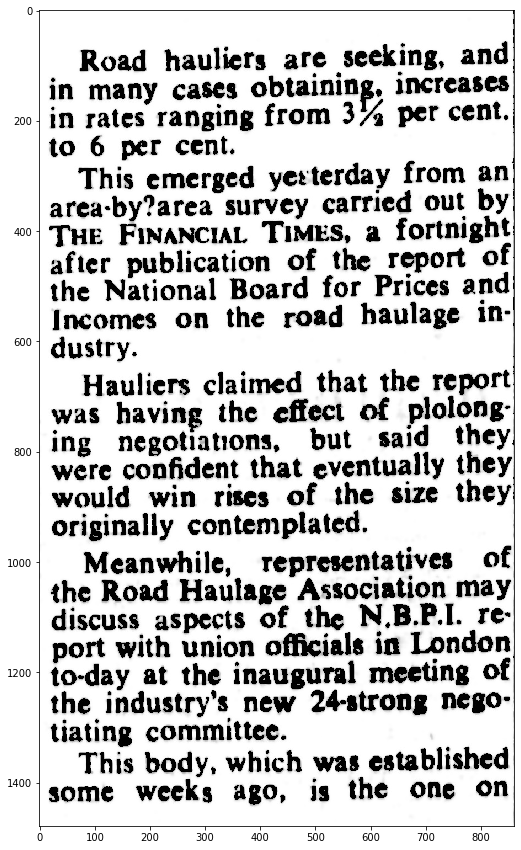

In [36]:
clear_text_img = cv2.imread('img/clean-text.jpg') 
showImg(clear_text_img)

#### Solution

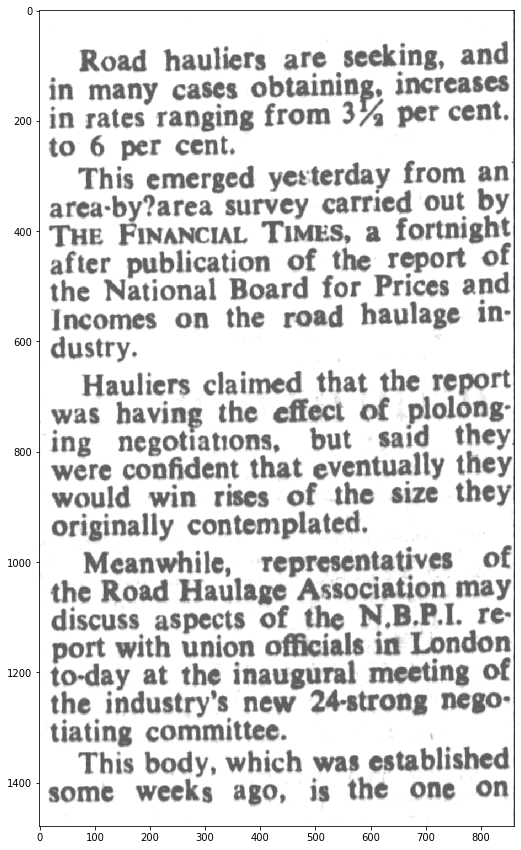

In [37]:
pixel_values_matrix = np.ones(text_img.shape, dtype= "uint8") * 90
brightened_image = cv2.add(text_img,pixel_values_matrix)
showImg(brightened_image)

In [38]:
hsv = cv2.cvtColor(brightened_image,cv2.COLOR_BGR2HSV)

True

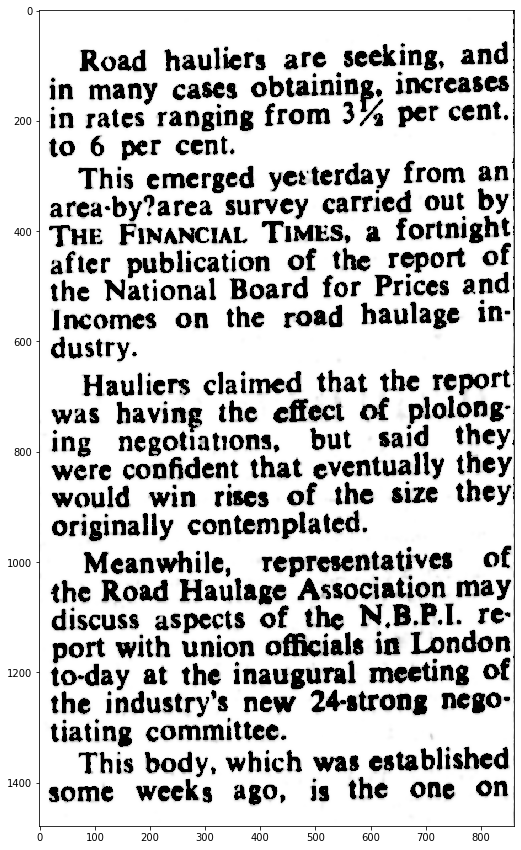

In [39]:
hsv = cv2.cvtColor(brightened_image,cv2.COLOR_BGR2HSV)
lower_range = (0,0,150)
upper_range = (0,0,255)
mask = cv2.inRange(hsv,lower_range,upper_range)

masked_image = np.copy(brightened_image)
masked_image[mask == 0] = [0,0,0]

blur = cv2.bilateralFilter(masked_image,9,75,75)
showImg(blur)
cv2.imwrite('img/clean-text.jpg', blur)

## Bitwise operations

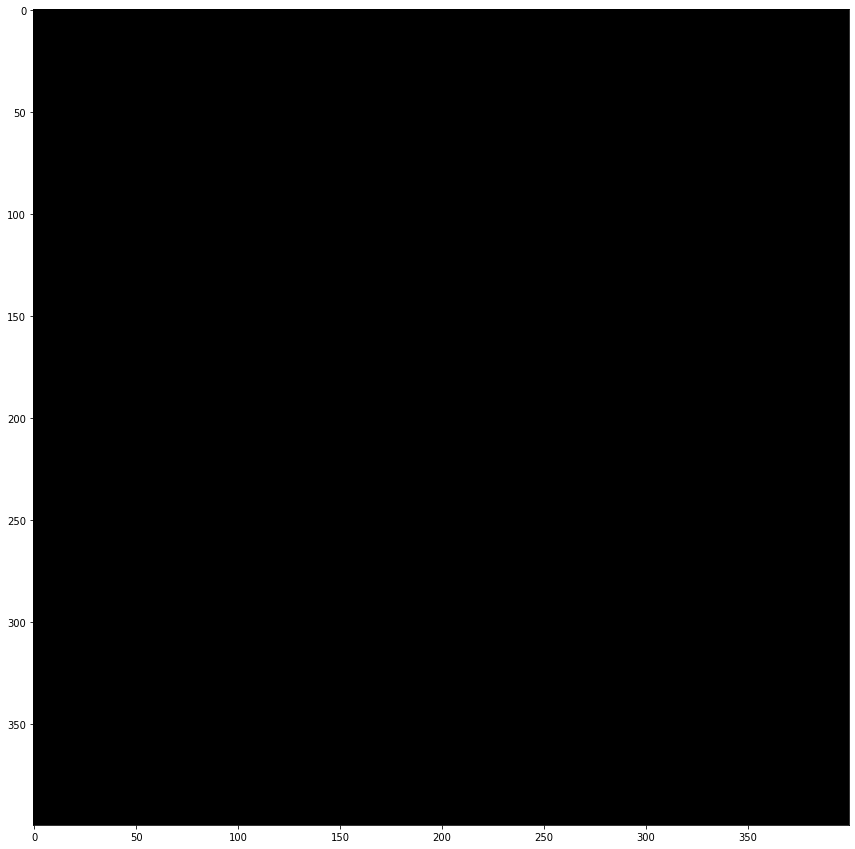

In [41]:
canvas = np.zeros((400,400), np.uint8)
showGrayScaleImg(canvas)

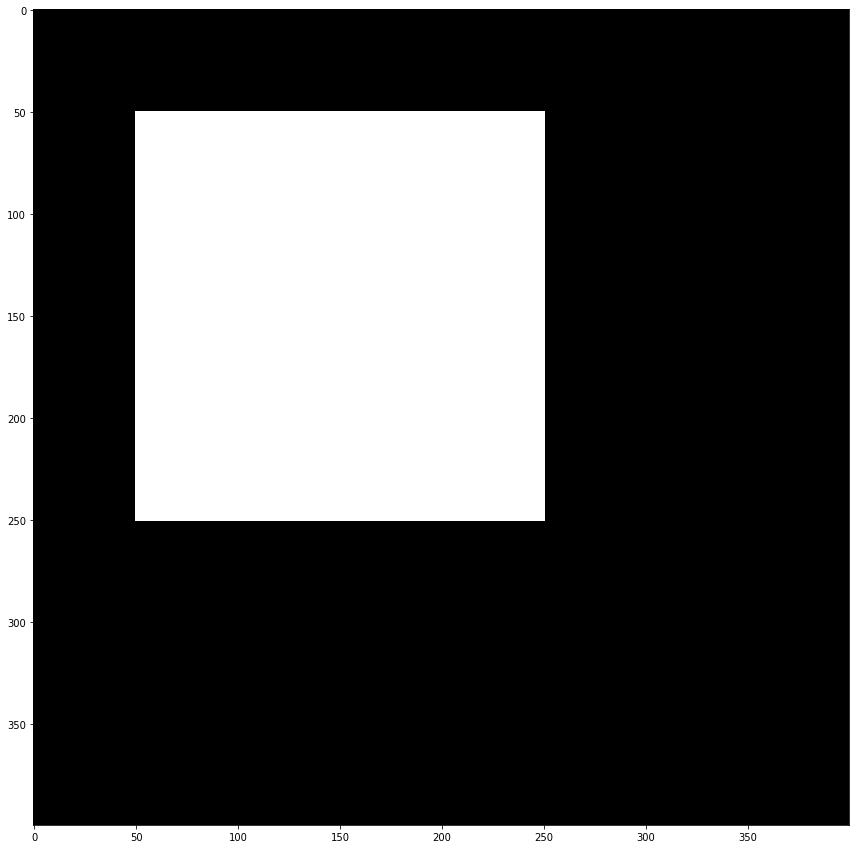

In [42]:
square = canvas.copy()
cv2.rectangle(square,(50,50),(250,250),255,-1)
showGrayScaleImg(square)

In [ ]:
circle = canvas.copy()
cv2.circle(circle,(200,200),100,255,-1)
showImg(circle)

In [ ]:
and_operation = cv2.bitwise_and(square, circle)
showImg(and_operation)

In [ ]:
or_operation = cv2.bitwise_or(circle,square)
showImg(or_operation)

In [ ]:
not_operation = cv2.bitwise_not(square)
showImg(not_operation)

In [ ]:
xor_operation = cv2.bitwise_xor(square,circle)
showImg(xor_operation)

## Blur

In [ ]:
showImg(barcelona)

In [ ]:
kernel = np.ones((7,7),np.float32)/49
print(kernel)
blur_img = cv2.filter2D(barcelona,-1,kernel)
showImg(blur_img)

In [ ]:
gaussia_blur = cv2.GaussianBlur(barcelona,(7,7),0)
showImg(gaussia_blur)

In [ ]:
blur = cv2.blur(barcelona,(5,5))
showImg(blur)

In [ ]:
blur = cv2.medianBlur(barcelona,5)
showImg(blur)

In [ ]:
blur = cv2.bilateralFilter(barcelona,9,75,75)
showImg(blur)

## Sharpening

In [43]:
sharpening_kernel = np.ones((3,3),np.float32)* -1
sharpening_kernel[1,1] =9
sharpening_kernel

array([[-1., -1., -1.],
       [-1.,  9., -1.],
       [-1., -1., -1.]], dtype=float32)

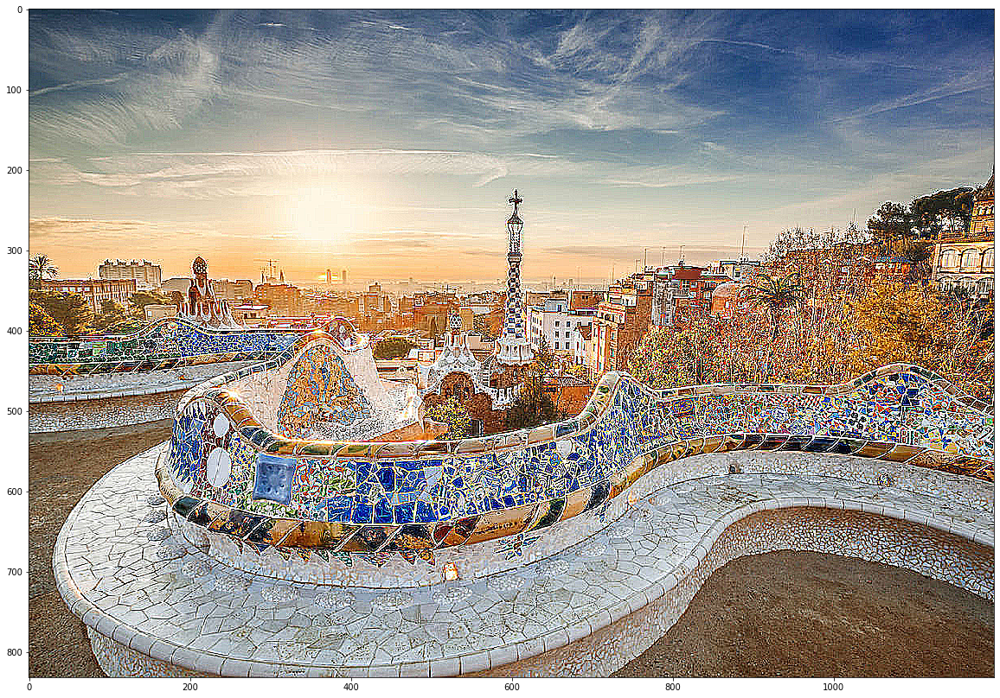

In [44]:
sharp_img = cv2.filter2D(barcelona,-1,sharpening_kernel)
showImg(sharp_img)

In [45]:
sharpening_kernel = np.ones((3,3),np.float32)* -1
sharpening_kernel[1,1] =9

In [46]:
sharpening_kernel

array([[-1., -1., -1.],
       [-1.,  9., -1.],
       [-1., -1., -1.]], dtype=float32)

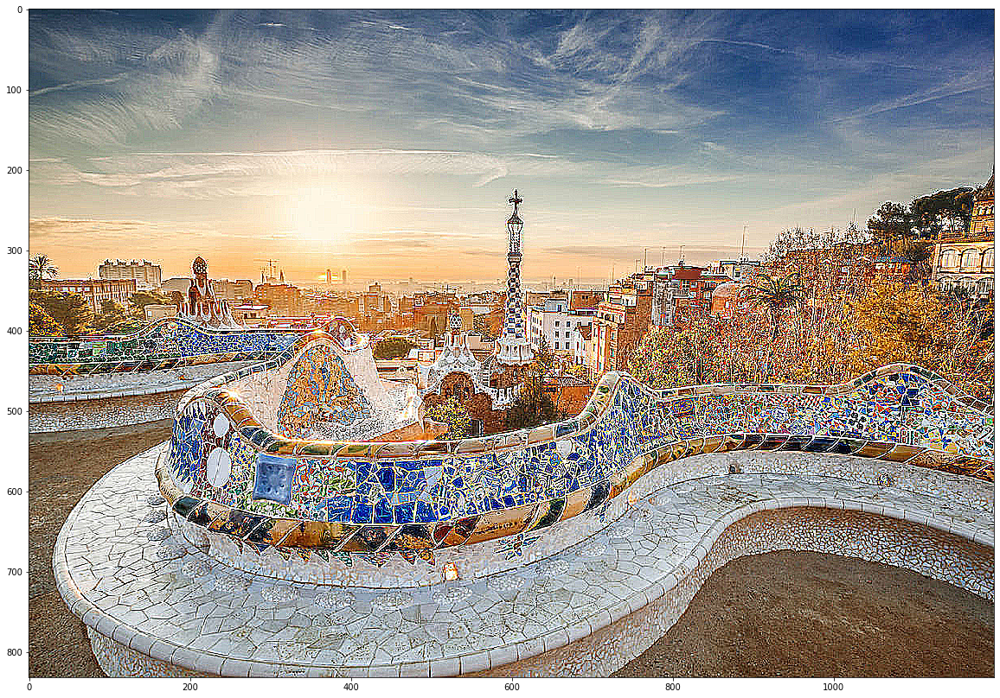

In [47]:
sharp_img = cv2.filter2D(barcelona,-1,sharpening_kernel)
showImg(sharp_img)

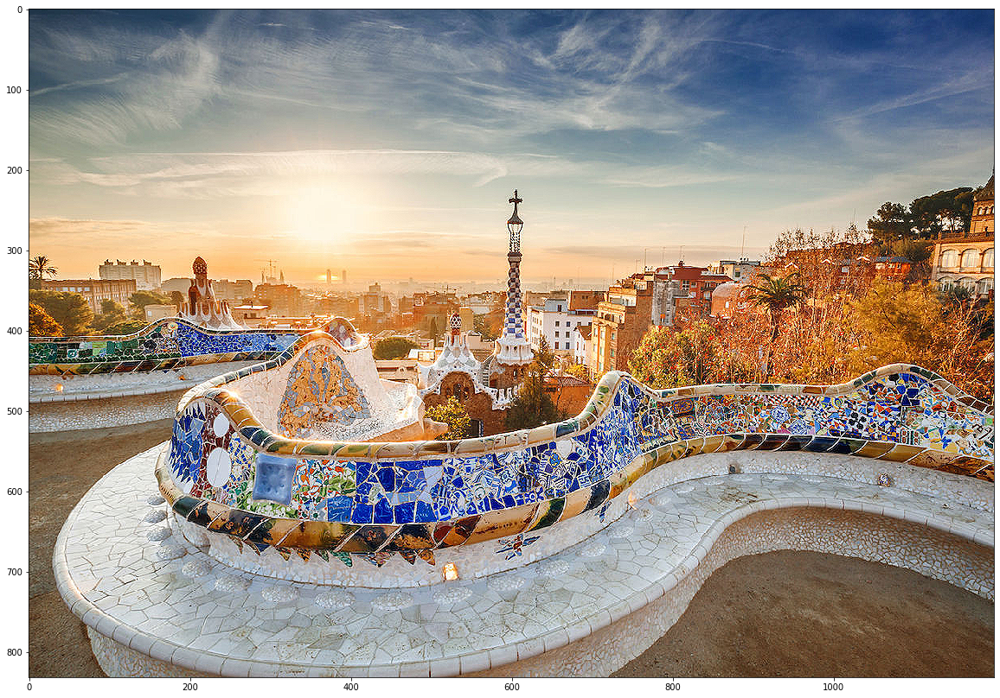

In [48]:
yet_another_kernel = np.array(
    [[  0  , -.5 ,    0 ],
     [-.5 ,   3  , -.5 ],
     [  0  , -.5 ,    0 ]], 
    np.float32)

sharp_img = cv2.filter2D(barcelona,-1,yet_another_kernel)
showImg(sharp_img)

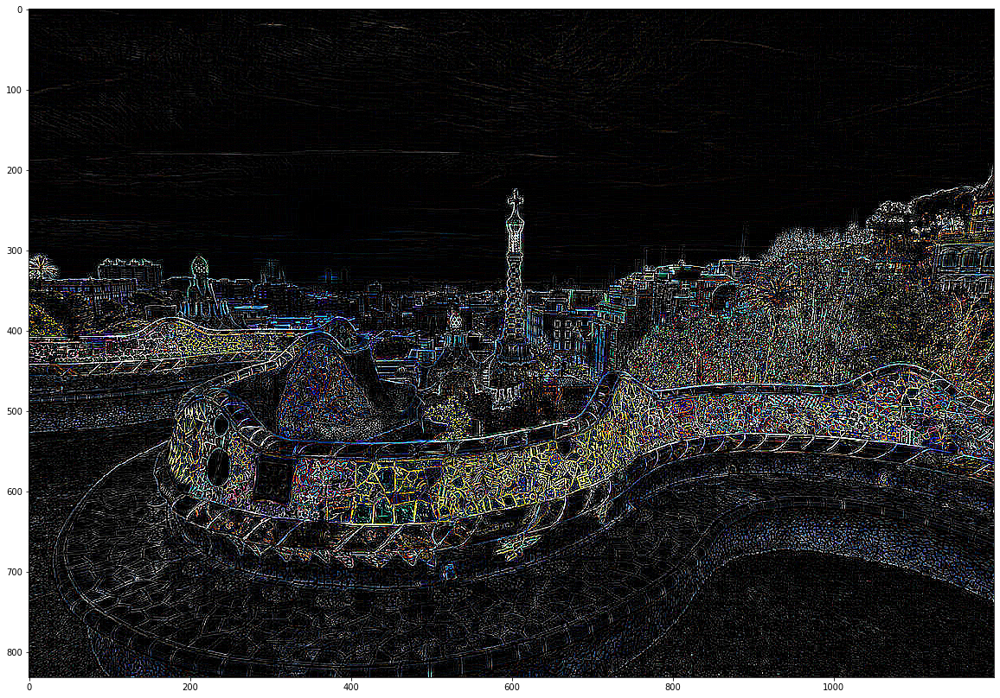

In [49]:
edge_detection_kernel = np.ones((3,3),np.float32)* -1
edge_detection_kernel[1,1] = 8
edges_img = cv2.filter2D(barcelona,-1,edge_detection_kernel)
showImg(edges_img)

In [50]:
edge_detection_kernel

array([[-1., -1., -1.],
       [-1.,  8., -1.],
       [-1., -1., -1.]], dtype=float32)

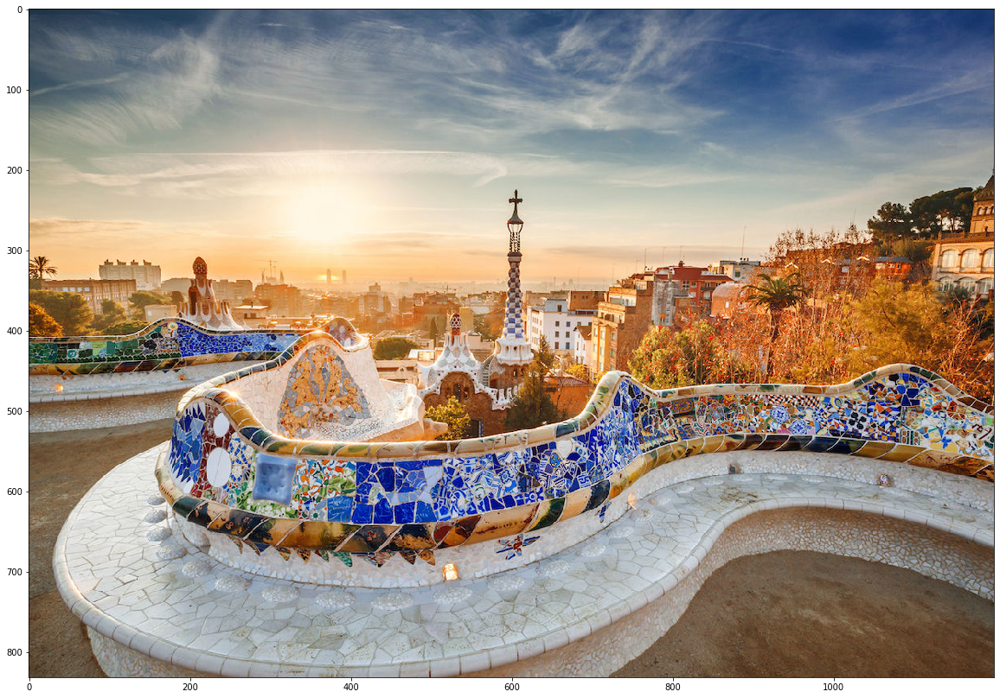

In [51]:
showImg(barcelona)

## Binarization also known as Thresholding

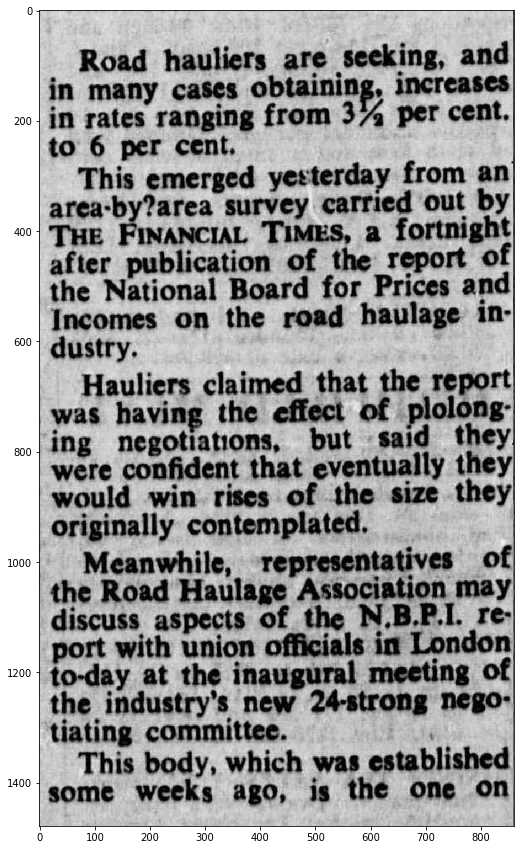

In [52]:
showImg(text_img)

In [ ]:
threshold = 127
max_value= 255

In [ ]:
ret1, thresh1 = cv2.threshold(text_img, threshold, max_value,
                              cv2.THRESH_BINARY)

ret2, thres_binary_inverted = cv2.threshold(text_img, threshold, max_value,
                                            cv2.THRESH_BINARY_INV)

ret3, thresh3 = cv2.threshold(text_img, threshold, max_value, cv2.THRESH_TRUNC)

ret4, thresh4 = cv2.threshold(text_img, threshold, max_value,
                              cv2.THRESH_TOZERO)

ret5, thresh5 = cv2.threshold(text_img, threshold, max_value,
                              cv2.THRESH_TOZERO_INV)

In [ ]:
print(ret1)
print(ret2)
print(ret3)
print(ret4)
print(ret5)

In [ ]:
titles = [
    'Original Image', 'BINARY', 'BINARY_INV', 'TRUNC', 'TOZERO', 'TOZERO_INV'
    ]

images = [text_img, thresh1, thres_binary_inverted, thresh3, thresh4, thresh5]

for i in range(6):
    showImg(images[i], titles[i])

In [ ]:
th2 = cv2.adaptiveThreshold(text_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                            cv2.THRESH_BINARY_INV, 11, 2)

th3 = cv2.adaptiveThreshold(text_img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,11,2)

titles = ['ADAPTIVE_THRESH_MEAN_C', 'ADAPTIVE_THRESH_GAUSSIAN_C']
images = [th2, th3]
for i in range(2):
    showImg(images[i], titles[i])

In [ ]:
grayscale_text_img = cv2.cvtColor(text_img, cv2.COLOR_BGR2GRAY)

th2 = cv2.adaptiveThreshold(grayscale_text_img, 255,
                            cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 31,
                            10)

th3 = cv2.adaptiveThreshold(grayscale_text_img,255,
                            cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
                            cv2.THRESH_BINARY,31,10)

titles = ['ADAPTIVE_THRESH_MEAN_C', 'ADAPTIVE_THRESH_GAUSSIAN_C']
images = [th2, th3]
for i in range(2):
    showImg(images[i], titles[i])

In [ ]:
notes_img = cv2.imread('img/notes.png',0)
showImg(notes_img)

In [ ]:
th2 = cv2.adaptiveThreshold(notes_img,255,cv2.ADAPTIVE_THRESH_MEAN_C,
                            cv2.THRESH_BINARY,21,3) 

th3 = cv2.adaptiveThreshold(notes_img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,21,3)

titles = ['ADAPTIVE_THRESH_MEAN_C','ADAPTIVE_THRESH_GAUSSIAN_C']
images = [th2,th3]
for i in range(2):
    showImg(images[i],titles[i])

In [ ]:
# Otsu's thresholding
ret2, otsu = cv2.threshold(grayscale_text_img, 127, 255,
                           cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Otsu's thresholding after Gaussian filtering
blur = cv2.GaussianBlur(grayscale_text_img, (5, 5), 0)

ret3, otsu_gaussianblur = cv2.threshold(blur, 0, 255,
                                        cv2.THRESH_BINARY + cv2.THRESH_OTSU)

print(ret3)
print(ret2)

titles = ['Otsu', 'Otzu after GaussianBlur']
images = [otsu, otsu_gaussianblur]

for i in range(2):
    showImg(images[i], titles[i])

## Dilation

In [ ]:
showImg(text_img)

In [ ]:
kernel = np.ones((3,3), np.uint8) 
dilated_text = cv2.dilate(text_img,kernel, iterations=2)

In [ ]:
showImg(dilated_text)

In [ ]:
showImg(thres_binary_inverted)
dilated_text = cv2.dilate(thres_binary_inverted,kernel, iterations=3)
showImg(dilated_text)

## Erosion

In [ ]:
eroded_text = cv2.erode(thres_binary_inverted,kernel, iterations=1)
showImg(eroded_text)

## Morphological Transformations: Opening / Closing

In [ ]:
#showImg(text_img)
opening = cv2.morphologyEx(text_img, cv2.MORPH_OPEN, kernel, iterations=2)
showImg(text_img)
showImg(opening)

In [ ]:
#showImg(thres_binary_inverted)
opening = cv2.morphologyEx(thres_binary_inverted,
                           cv2.MORPH_OPEN,
                           kernel,
                           iterations=1)
showImg(opening)

In [ ]:
showImg(text_img)
closing = cv2.morphologyEx(text_img, cv2.MORPH_CLOSE, kernel, iterations=2)
showImg(closing)

In [ ]:
showImg(thres_binary_inverted)
closing = cv2.morphologyEx(thres_binary_inverted,
                           cv2.MORPH_CLOSE,
                           kernel,
                           iterations=1)
showImg(closing)

In [ ]:
#showImg(thres_binary_inverted)
closing = cv2.morphologyEx(thres_binary_inverted, cv2.MORPH_RECT, kernel, iterations=1)
showImg(closing)

In [55]:
grayscale_bcn = cv2.cvtColor(barcelona,cv2.COLOR_BGR2GRAY)

## Edge detection

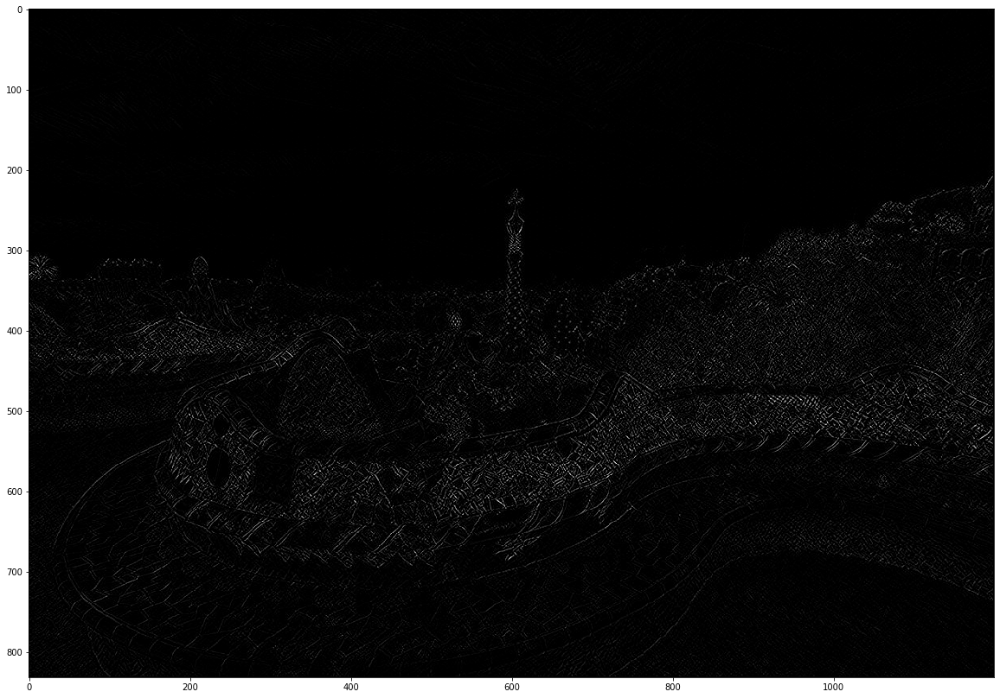

In [57]:
scale = 1
delta = 0
x_orientation = 1
y_orientation = 1
ddepth = cv2.CV_16U
edges = cv2.Sobel(grayscale_bcn,
                  ddepth,
                  x_orientation,
                  y_orientation,
                  ksize=3,
                  scale=scale,
                  delta=delta,
                  borderType=cv2.BORDER_DEFAULT)
showGrayScaleImg(edges)

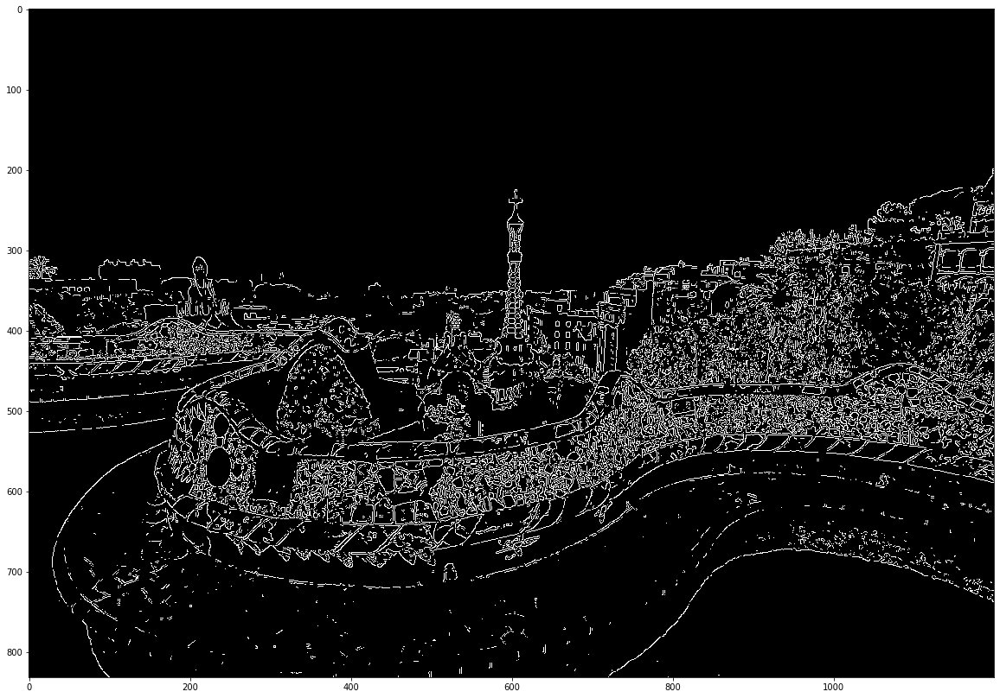

In [58]:
#showImg(gaussia_blur)
edges = cv2.Canny(grayscale_bcn,220,255)
showGrayScaleImg(edges)

### Min Area

## Perspective

In [ ]:
image = cv2.imread('img/scan.jpg')

showImg(image)

# Cordinates of the 4 corners of the original image
points_A = np.float32([[320,15], [700,215], [85,610], [530,780]])

# Cordinates of the 4 corners of the desired output
# We use a ratio of an A4 Paper 1 : 1.41
points_B = np.float32([[0,0], [420,0], [0,594], [420,594]])
 
# Use the two sets of four points to compute 
# the Perspective Transformation matrix, M    
M = cv2.getPerspectiveTransform(points_A, points_B)
 
warped = cv2.warpPerspective(image, M, (420,594))

showImg(warped)


## Skewed Text

In [ ]:
skew_text = cv2.imread('img/skew_text.jpg')
showImg(ticket)

In [ ]:
grayscaled_skew_text = cv2.imread('img/skew_text.jpg',0)
showImg(grayscaled_skew_text)

In [ ]:
negative_image = cv2.bitwise_not(grayscaled_skew_text)
ret, thresh = cv2.threshold(negative_image,0,255,cv2.THRESH_BINARY | cv2.THRESH_OTSU)
showGrayScaleImg(thresh)

In [ ]:
coords = np.column_stack(np.where(thresh > 0))
angle = cv2.minAreaRect(coords)[-1]
 
# the `cv2.minAreaRect` function returns values in the
# range [-90, 0); as the rectangle rotates clockwise the
# returned angle trends to 0 -- in this special case we
# need to add 90 degrees to the angle
if angle < -45:
    angle = -(90 + angle)
 
# otherwise, just take the inverse of the angle to make
# it positive
else:
    angle = -angle

In [ ]:
(h, w) = grayscaled_skew_text.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, angle, 1.0)
rotated = cv2.warpAffine(grayscaled_skew_text, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)

In [ ]:
showImg(rotated)

In [ ]:
skew_page = cv2.imread('img/skew_page.png')
showImg(skew_page)
grayscaled_skew_page = cv2.imread('img/skew_page.png',0)
negative_image = cv2.bitwise_not(grayscaled_skew_page)
ret, thresh = cv2.threshold(negative_image,0,255,cv2.THRESH_BINARY | cv2.THRESH_OTSU)
showGrayScaleImg(thresh)

coords = np.column_stack(np.where(thresh > 0))
angle = cv2.minAreaRect(coords)[-1]

if angle < -45:
    angle = -(90 + angle)
else:
    angle = -angle
    
(h, w) = grayscaled_skew_page.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, angle, 1.0)
rotated = cv2.warpAffine(grayscaled_skew_page, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)

showImg(rotated)

# Mini Projects

## Level 1

### Photo art app

1. Create a function that receives an image and converts it to a sketch so it looks similar to this:
![Example 1](img/sketch.png)

### Photo correction app

1. Create a function that given a photo of your notes with bad ilumination it changes the image so it can be read

### Instagram filters app

1. Create a function that given a photo it applies a black and white filter
1. Create a filter that will change color of the image 

## Level 2

### Photo art app

1. Change the app so it can now do the same but using your webcam to make it in real time  
**Hint:** you can use ```cv2.VideoCapture(0)```

### Photo correction app

1. Create a funtion to clean *noise* from images
![Noisy image](img/n.png)

### Instagram filters app

1. Create a function that applies a sepia filter to the image, for a BGR image apply this kernel:
        [0.272, 0.534, 0.131],
        [0.349, 0.686, 0.168],
        [0.393, 0.769, 0.189]
        
Get the BGR value of the pixel.
Calculate tr, tg and tb using the formula

tb = 0.272R + 0.534G + 0.131B
tg = 0.349R + 0.686G + 0.168B
tr = 0.393R + 0.769G + 0.189B

Take the integer value.

Set the new RGB value of the pixel as per the following condition:

If tb > 255 then b = 255 else b = tb
If tg > 255 then g = 255 else g = tg
If tr > 255 then r = 255 else r = tr


Example:

Consider a color pixel with the following values

A = 255

R = 100

G = 150

B = 200

Where A, R, G and B represents the Alpha, Red, Green and Blue value of the pixel.

Remember! ARGB will have an integer value in the range 0 to 255.

So, to convert the color pixel into sepia pixel we have to first calculate tr, tg and tb.

tr = 0.393(100) + 0.769(150) + 0.189(200)

tr = 192.45

tr = 192 (taking integer value)

Similarly,

tg = 0.349(100) + 0.686(150) + 0.168(200) = 171 (taking integer value)

and tb = 0.272(100) + 0.534(150) + 0.131(200) = 133 (taking integer value)

## Level 3

### Instagram filters app

1. Apply the sepia filter by using the cv2.transfor function
1. Create different filters from the sepia filter so it renders different images

# More projects

## Handwriting recognition

1. Write a one digit number (from 0 to 9) on a paper and using your mobile phone take a picture of it
1. Crop the image manually and pass it to a a function that will process it so it looks like a char in the MNIST dataset, make sure it is the correct size as well
![4](img/4.png)

1. Pass it through a MNIST classifier and print the prediction on screen

1. Modify the image so now it also contains the predicted result on the image
1. Try it with all digits